In [1]:
import pandas as pd
import numpy as np
import requests
from datetime import datetime, timedelta
import time
import yfinance as yf
from matplotlib import pyplot as plt

import sys
import pickle
import plotly.graph_objs as go
import plotly.io as pio

sys.path.append('C://Users/Ray/PycharmProjects/jump_exercise/jump_exercise/')

from python.src.utils.realized_volatility_beta_calculators import *

import warnings

# Filter out pandas warnings
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=DeprecationWarning)
warnings.filterwarnings('ignore', category=pd.core.generic.SettingWithCopyWarning)


C:\Users\Ray\AppData\Local\Temp\ipykernel_8396\2923131146.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Retrieving Data from YFinance

- We retrieve for the last 2y at 1h granularity
- Overall only small differences in missing data which is handled in functions so data quality seems decent, I manually compared recent prices with Google Finance and the API quality seemed sufficient.

In [2]:
ETF_PRICES_2Y = {}

for ticker in ['SPY', 'QQQ', 'IWM', 'GLD', 'TLT', 'XLF', 'XLE', 'DIA', 'TQQQ', 'EEM', 'VHT', 'HYG', 'XLC', 'VMBS', 'SLV', 'ARKK']:
    time_start = time.time()
    etf = yf.Ticker(ticker)
    etf_data = etf.history(period="2y", interval='1h') 

    time_end = time.time()
    print(f'{ticker}: Elapsed Time: {time_end - time_start}, DF Length: {len(etf_data)}') 

    ETF_PRICES_2Y[ticker] = etf_data

SPY: Elapsed Time: 0.3510711193084717, DF Length: 3500
QQQ: Elapsed Time: 0.16607403755187988, DF Length: 3502
IWM: Elapsed Time: 0.2040400505065918, DF Length: 3502
GLD: Elapsed Time: 0.17287731170654297, DF Length: 3502
TLT: Elapsed Time: 0.15563464164733887, DF Length: 3502
XLF: Elapsed Time: 0.14104914665222168, DF Length: 3502
XLE: Elapsed Time: 0.24132132530212402, DF Length: 3502
DIA: Elapsed Time: 0.1451268196105957, DF Length: 3502
TQQQ: Elapsed Time: 0.18954873085021973, DF Length: 3500
EEM: Elapsed Time: 0.16231560707092285, DF Length: 3502
VHT: Elapsed Time: 0.16740942001342773, DF Length: 3504
HYG: Elapsed Time: 0.20192742347717285, DF Length: 3502
XLC: Elapsed Time: 0.20616602897644043, DF Length: 3502
VMBS: Elapsed Time: 0.20808053016662598, DF Length: 3502
SLV: Elapsed Time: 0.22617292404174805, DF Length: 3495
ARKK: Elapsed Time: 0.1850450038909912, DF Length: 3502


In [22]:
# Pickle data so don't need to re-retrieve
# with open('etf_2y_data.pkl', 'wb') as file:
#     pickle.dump(ETF_PRICES_2Y, file)

# Compute and Plot 30-Day Realized Volatility For Basket of ETFs  

In [3]:
ETF_30DAY_REALIZED_VOLATILITIES = {}

for ticker in ETF_PRICES_2Y:
    time_start = time.time()
    etf_data = ETF_PRICES_2Y[ticker]
    realized_volatility_time_series = compute_realized_volatility_time_series_single_etf(
        etf_price_data = etf_data,
        price_type = 'Close',
        rolling_window_days = 30,
        price_frequency_hours = 1,
    )
    ETF_30DAY_REALIZED_VOLATILITIES[ticker] = realized_volatility_time_series

    time_end = time.time()
    print(f'{ticker}: Elapsed Time: {time_end - time_start}') 
    

SPY: Elapsed Time: 0.0030045509338378906
QQQ: Elapsed Time: 0.0009996891021728516
IWM: Elapsed Time: 0.0009996891021728516
GLD: Elapsed Time: 0.0020008087158203125
TLT: Elapsed Time: 0.0010004043579101562
XLF: Elapsed Time: 0.0025370121002197266
XLE: Elapsed Time: 0.002002716064453125
DIA: Elapsed Time: 0.0020003318786621094
TQQQ: Elapsed Time: 0.0020003318786621094
EEM: Elapsed Time: 0.002000093460083008
VHT: Elapsed Time: 0.0025069713592529297
HYG: Elapsed Time: 0.002002239227294922
XLC: Elapsed Time: 0.0010018348693847656
VMBS: Elapsed Time: 0.0009996891021728516
SLV: Elapsed Time: 0.0010001659393310547
ARKK: Elapsed Time: 0.0020003318786621094


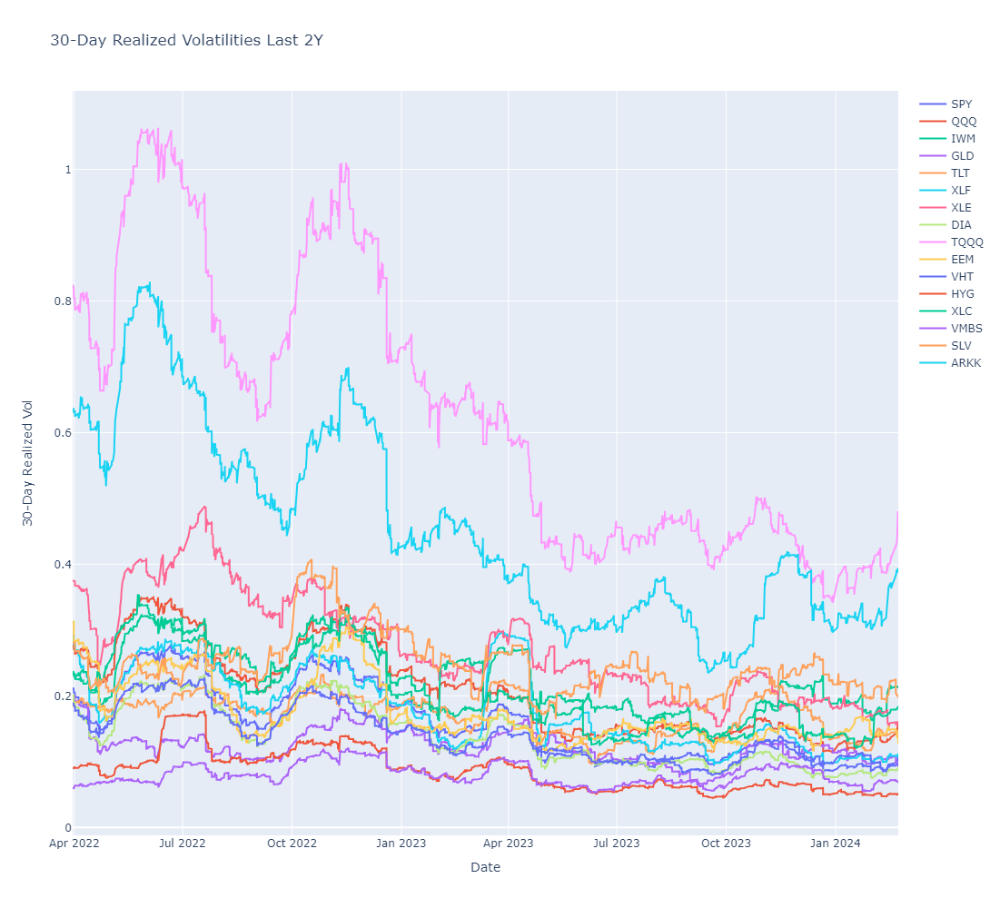

In [4]:
traces = []
for etf_name in ETF_30DAY_REALIZED_VOLATILITIES:
    etf_data = ETF_30DAY_REALIZED_VOLATILITIES[etf_name]
    trace = go.Scatter(
        x=etf_data.index,
        y=etf_data,
        mode='lines',
        name=etf_name
    )
    traces.append(trace)

# Create layout for the plot
layout = go.Layout(
    title='30-Day Realized Volatilities Last 2Y',
    xaxis=dict(title='Date'),
    yaxis=dict(title='30-Day Realized Vol'),
    hovermode='closest',
    height=1000,
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show the interactive plot
pio.show(fig)

In general, the realized vol metrics should be spread against the IVs for the same rolling period (e.g. 30 Day RV v. 30 Day IV) and compared across similar ETFs / within same sectors. Below, I do a bit of deeper digging into some RV relationships between the highly correlated QQQ and TQQQ to see if there are any interesting phenomena. 

I didn't have time to do this, but one area (if given more time) I would investigate is comparing the RVs over different time horizons and granularity of stock returns. Ideally a team should be using various horizons of RV metrics (short and long term) to help guide positioning and risk management. Comparing across various horizons also provides additional measurement of the robustness in my RV calculations (e.g. similar horizon RVs should have ballpark same values).

# Compute and Plot 30-Day Running Betas against SPY

In [5]:
ETF_ROLLING_BETAS_AGAINST_SPY = {}

for ticker in ETF_PRICES_2Y:
    if ticker == 'SPY':
        continue
    time_start = time.time()
    non_spy_etf_data = ETF_PRICES_2Y[ticker]
    rolling_betas_against_spy = compute_rolling_betas_against_benchmark(
        target_etf_prices = non_spy_etf_data,
        benchmark_etf_prices = ETF_PRICES_2Y['SPY'],
        price_type = 'Close',
        rolling_window_days = 30,
        price_frequency_hours = 1,
    )
    ETF_ROLLING_BETAS_AGAINST_SPY[ticker] = rolling_betas_against_spy

    time_end = time.time()
    print(f'{ticker}: Elapsed Time: {time_end - time_start}') 
    

QQQ: Elapsed Time: 0.8928999900817871
IWM: Elapsed Time: 0.8573706150054932
GLD: Elapsed Time: 0.8933327198028564
TLT: Elapsed Time: 0.8540105819702148
XLF: Elapsed Time: 0.8278191089630127
XLE: Elapsed Time: 0.8046047687530518
DIA: Elapsed Time: 0.8088579177856445
TQQQ: Elapsed Time: 0.8056814670562744
EEM: Elapsed Time: 0.8139584064483643
VHT: Elapsed Time: 0.8151218891143799
HYG: Elapsed Time: 0.8462095260620117
XLC: Elapsed Time: 0.8147892951965332
VMBS: Elapsed Time: 0.8197641372680664
SLV: Elapsed Time: 0.7979962825775146
ARKK: Elapsed Time: 0.8389675617218018


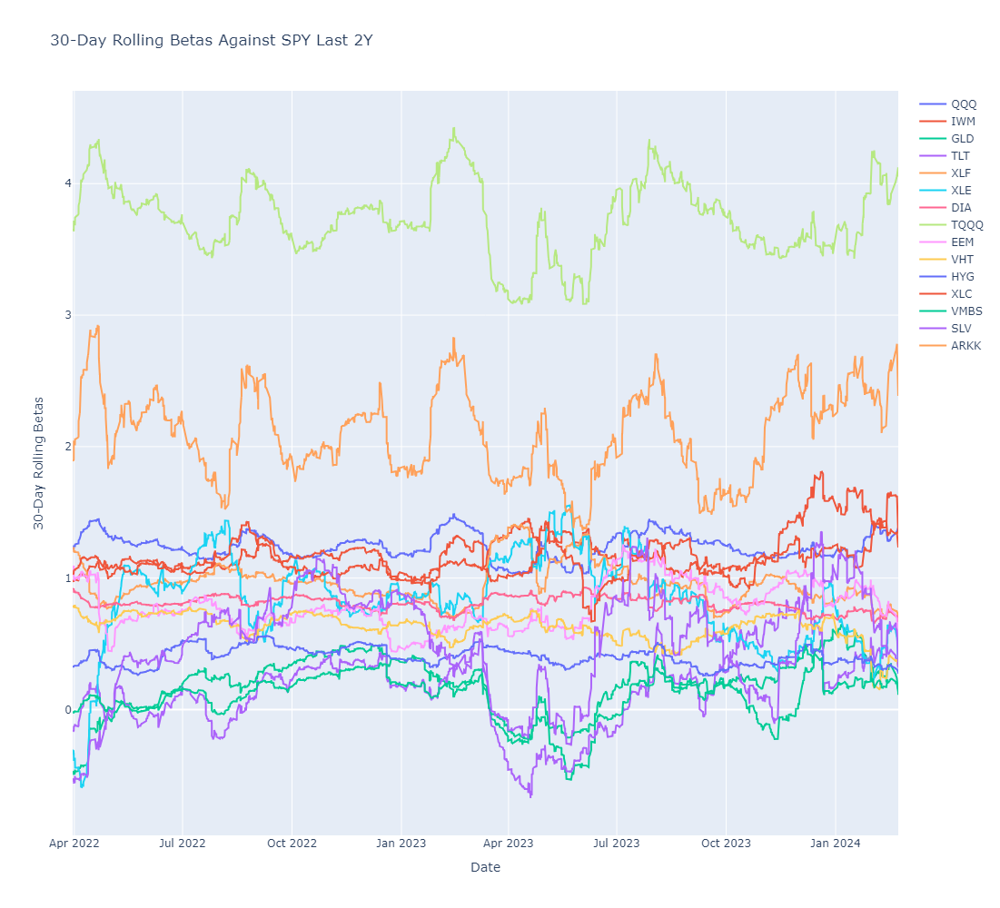

In [6]:
traces = []
for etf_name in ETF_ROLLING_BETAS_AGAINST_SPY:
    etf_data = ETF_ROLLING_BETAS_AGAINST_SPY[etf_name]
    trace = go.Scatter(
        x=etf_data.index,
        y=etf_data,
        mode='lines',
        name=etf_name
    )
    traces.append(trace)

# Create layout for the plot
layout = go.Layout(
    title='30-Day Rolling Betas Against SPY Last 2Y',
    xaxis=dict(title='Date'),
    yaxis=dict(title='30-Day Rolling Betas'),
    hovermode='closest',
    height=1000,
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show the interactive plot
pio.show(fig)

The rolling betas with SPY across the ETFs exhibit patterns among similar ETFs (e.g. ETFs within the same sector). A few common patterns that stick out to me: SLV v. GLD (both ETFs that track heavy metals) and ARKK <> QQQ <> TQQ (all ETFs with heavy tech exposure). For these similar sector ETFs that have fairly similar underlying exposures, you can likely spread trade them in SPY-equivalent terms: when their individual betas to SPY diverge compared to a historical level, that likely presents a relative value opportunity.  

Another framing: if an ETF is moving drastically different than it's historical beta relative to SPY that is potentially an interesting moment to investigate deeper for edge. Just looking at the historical betas over the last 2y, ETFs seem to have relatively sticky / ranges for their betas wrt SPY.   

# Compute and Plot Realized Volatility Correlations to SPY

In [7]:
ETF_REALIZED_CORRELATION_AGAINST_SPY = {}

for ticker in ETF_PRICES_2Y:
    if ticker == 'SPY':
        continue
        
    time_start = time.time()
    non_spy_etf_data = ETF_PRICES_2Y[ticker]
    realized_vol_correlations_against_spy = compute_rolling_realized_correlation_against_benchmark(
        target_etf_prices = non_spy_etf_data,
        benchmark_etf_prices = ETF_PRICES_2Y['SPY'],
        price_type = 'Close',
        rolling_window_days = 30,
        price_frequency_hours = 1,
    )
    ETF_REALIZED_CORRELATION_AGAINST_SPY[ticker] = realized_vol_correlations_against_spy

    time_end = time.time()
    print(f'{ticker}: Elapsed Time: {time_end - time_start}') 

QQQ: Elapsed Time: 0.005949258804321289
IWM: Elapsed Time: 0.004003047943115234
GLD: Elapsed Time: 0.004503488540649414
TLT: Elapsed Time: 0.004213094711303711
XLF: Elapsed Time: 0.004001140594482422
XLE: Elapsed Time: 0.004363536834716797
DIA: Elapsed Time: 0.004000663757324219
TQQQ: Elapsed Time: 0.003522157669067383
EEM: Elapsed Time: 0.004003047943115234
VHT: Elapsed Time: 0.0050106048583984375
HYG: Elapsed Time: 0.003027200698852539
XLC: Elapsed Time: 0.0039997100830078125
VMBS: Elapsed Time: 0.0038771629333496094
SLV: Elapsed Time: 0.007003307342529297
ARKK: Elapsed Time: 0.007541656494140625


In [8]:
ETF_REALIZED_CORRELATION_AGAINST_SPY['QQQ']

Datetime
2022-05-06 12:30:00-04:00    0.924418
2022-05-06 13:30:00-04:00    0.925426
2022-05-06 14:30:00-04:00    0.926565
2022-05-06 15:30:00-04:00    0.928105
2022-05-09 09:30:00-04:00    0.930491
                               ...   
2024-02-22 11:30:00-05:00    0.551819
2024-02-22 12:30:00-05:00    0.594862
2024-02-22 13:30:00-05:00    0.632157
2024-02-22 14:30:00-05:00    0.658156
2024-02-22 15:30:00-05:00    0.680719
Name: log_returns, Length: 2956, dtype: float64

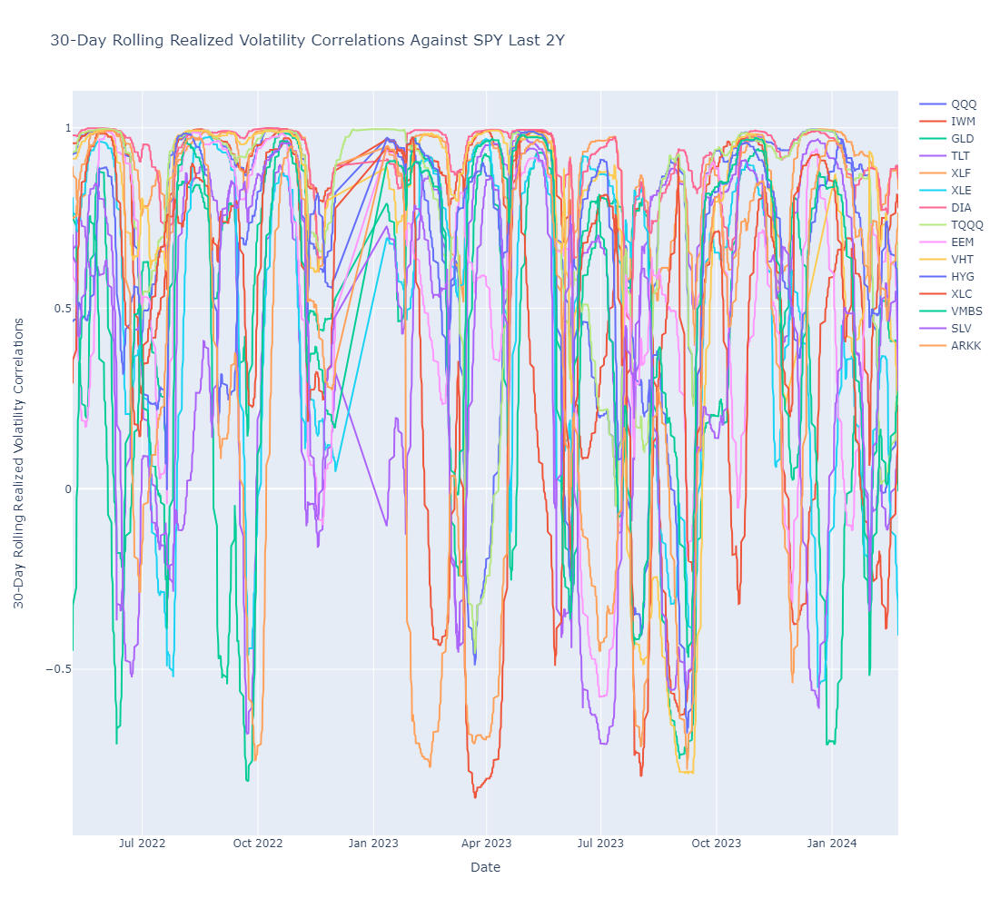

In [10]:
traces = []
for etf_name in ETF_REALIZED_CORRELATION_AGAINST_SPY:
    etf_data = ETF_REALIZED_CORRELATION_AGAINST_SPY[etf_name]
    trace = go.Scatter(
        x=etf_data.index,
        y=etf_data,
        mode='lines',
        name=etf_name
    )
    traces.append(trace)

# Create layout for the plot
layout = go.Layout(
    title='30-Day Rolling Realized Correlations Against SPY Last 2Y',
    xaxis=dict(title='Date'),
    yaxis=dict(title='30-Day Rolling Realized Volatility Correlations'),
    hovermode='closest',
    height=1000,
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show the interactive plot
pio.show(fig)

My realized correlation metrics seem potentially off to me due to how choppy it is, so would like to discuss this more with the team if possible -- this is one metric that I have very little experience with among the other metrics in the exercise. One intuition to me is that the sharp divergences in realized volatility correlation between SPY / the other basket ETFs present an opportunity to dig deeper (assuming it isn't an artifact of a mistake in my approach). 

Would love to discuss more regarding this area.

# An Investigation into TQQQ <> QQQ <> ARKK

These 3 ETFs caught my eye just given my own understanding of them, plus the fact that across all above metrics, they exhibited very similar patterns bar some scalar differences (e.g. 3x leverage). So I wanted dig into this more to see if there were ever any discrepancies in RV relationships / betas, even if I scaled QQQ by 3x leverage. 

From the plots, QQQ <> TQQQ seems to be relatively efficient RV-wise (almost always tracking perfectly) and their betas with SPY too. This likely is because ETF market makers are keeping their pricing very in-line through arbitrage. However, if we are trading options then IV is where we could extract edge, knowing that RVs are well in-line between the 2: if implied vol ever dislocates (e.g. due to flow) between QQQ and TQQQ that likely should be a spread that converges.  

Eyeballing ARKK, it looks ~1.5x is a decent multiplier to TQQQ RV / betas.

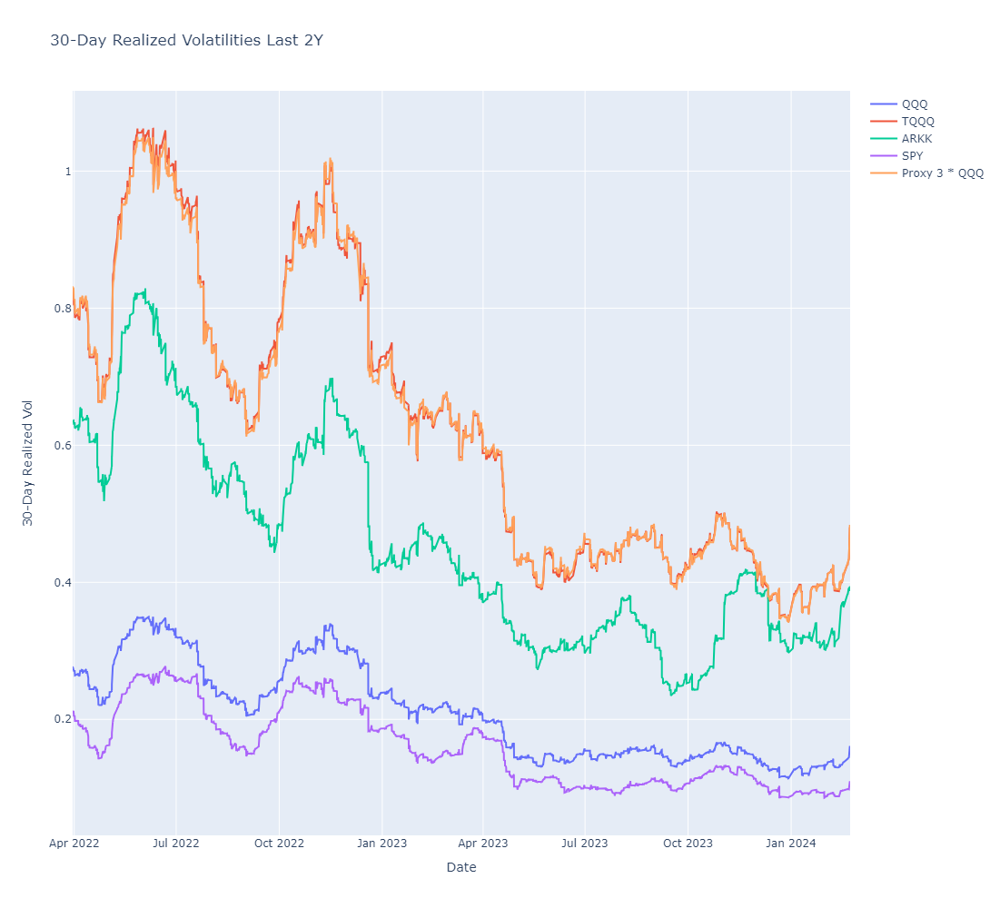

In [14]:
traces = []
for etf_name in ['QQQ', 'TQQQ', 'ARKK', 'SPY']:
    etf_data = ETF_30DAY_REALIZED_VOLATILITIES[etf_name]
    trace = go.Scatter(
        x=etf_data.index,
        y=etf_data,
        mode='lines',
        name=etf_name
    )
    traces.append(trace)

# Added a 3 * QQQ 
proxy_tqqq = 3 * ETF_30DAY_REALIZED_VOLATILITIES['QQQ']
trace = go.Scatter(
        x=proxy_tqqq.index,
        y=proxy_tqqq,
        mode='lines',
        name='Proxy 3 * QQQ'
    )
traces.append(trace)


# Create layout for the plot
layout = go.Layout(
    title='30-Day Realized Volatilities Last 2Y',
    xaxis=dict(title='Date'),
    yaxis=dict(title='30-Day Realized Vol'),
    hovermode='closest',
    height=1000,
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show the interactive plot
pio.show(fig)

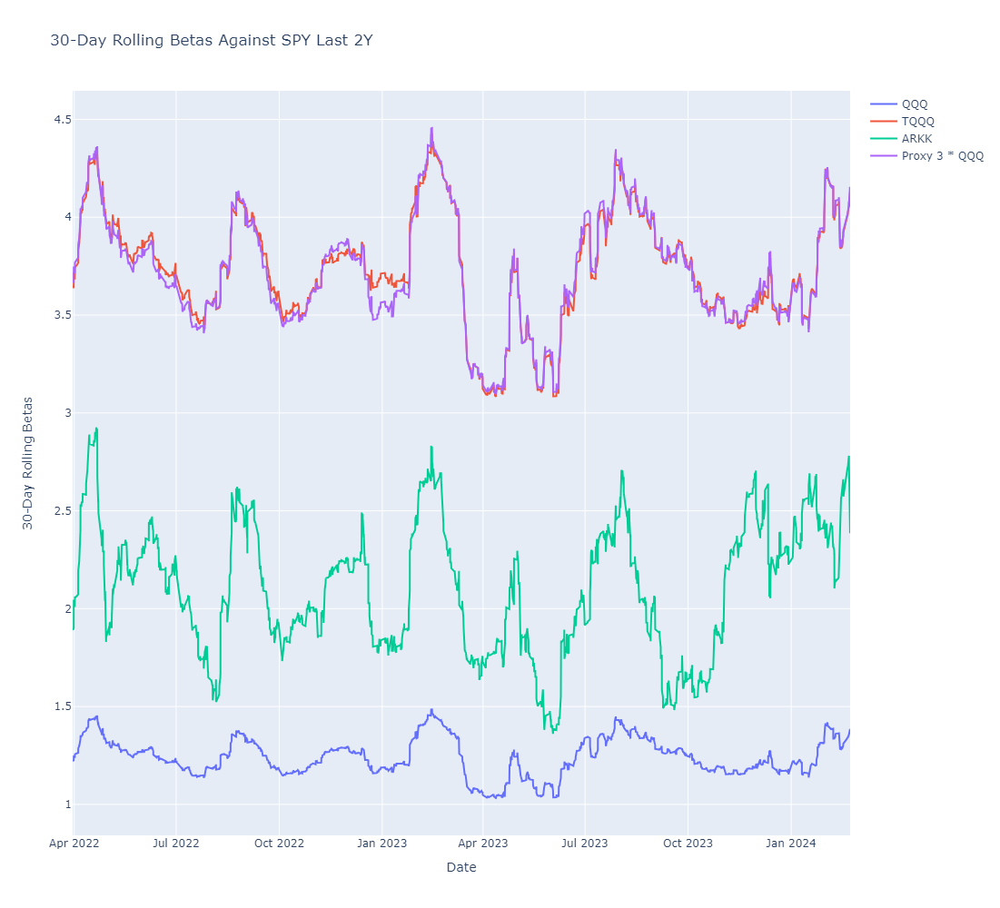

In [15]:
traces = []
for etf_name in ['QQQ', 'TQQQ', 'ARKK']:
    etf_data = ETF_ROLLING_BETAS_AGAINST_SPY[etf_name]
    trace = go.Scatter(
        x=etf_data.index,
        y=etf_data,
        mode='lines',
        name=etf_name
    )
    traces.append(trace)

# Added a 3 * QQQ 
proxy_tqqq = 3 * ETF_ROLLING_BETAS_AGAINST_SPY['QQQ']
trace = go.Scatter(
        x=proxy_tqqq.index,
        y=proxy_tqqq,
        mode='lines',
        name='Proxy 3 * QQQ'
    )
traces.append(trace)

# Create layout for the plot
layout = go.Layout(
    title='30-Day Rolling Betas Against SPY Last 2Y',
    xaxis=dict(title='Date'),
    yaxis=dict(title='30-Day Rolling Betas'),
    hovermode='closest',
    height=1000,
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show the interactive plot
pio.show(fig)

# Last Thoughts 
1. If I had to develop a beta for a newly listed name, my approach would be to look at what sectors the ETF is for and what is in its basket. As we demonstrate in the QQQ <> TQQQ <> ARKK investigation above, these ETFs track very similarly to each other with the determining factor being leverage for QQQ <> TQQQ. I didn't get to dig deep into ARKK's basket but you can likely explain why it is approximately ~2x more volatile than QQQ. For a new ETF, I will heavily base it off similar sector ETFs then look at the prospectus for potential differentiators (e.g. leverage, if there's any obvious symbol overweighting, etc). However, this approach could decouple if its suddenly a new wave of ETFs (e.g. the recent BTC ETFs). For this case, I would compare it with GBTC (it was a Trust not an ETF but likely tracked well) and then also proxy with the actual BTC commodity betas / realize vol / correlations with SPY. In general, it seems leveraging either similar ETFs or the underlying basket is a valid approach to price betas for a new ETF.
2. Its been many years since I've dabbled in time series models (didn't leverage any of these methods at IMC or crypto), but if memory serves correct I think GARCH/ARCH models could be used instead of OLS. 